In [38]:
# import spacec first
import spacec as sp

# import standard packages
import os
import warnings
import numpy as np
import scanpy as sc
import matplotlib
import pickle
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import scipy.stats as stats
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.neighbors import kneighbors_graph
import scanpy as sc
from sklearn.neighbors import kneighbors_graph
import igraph as ig
import leidenalg
import umap


warnings.filterwarnings('ignore')

sc.settings.set_figure_params(dpi=80, facecolor='white') 
# set the default color map to viridis, the below paramters can be chanaged
matplotlib.rcParams["image.cmap"] = 'viridis'
# import spacec first

warnings.filterwarnings('ignore')

from cellpose import models

print(models.MODEL_NAMES)


['cyto3', 'nuclei', 'cyto2_cp3', 'tissuenet_cp3', 'livecell_cp3', 'yeast_PhC_cp3', 'yeast_BF_cp3', 'bact_phase_cp3', 'bact_fluor_cp3', 'deepbacs_cp3', 'cyto2', 'cyto', 'transformer_cp3', 'neurips_cellpose_default', 'neurips_cellpose_transformer', 'neurips_grayscale_cyto2']


In [4]:
# Specify the path to the data
root_path = "/dss/dsshome1/00/ge65tib2/Spacec/" # replace with your path
data_path = root_path + 'example_data/raw/' # where the data is stored

# where you want to store the output
output_dir = root_path + 'example_data/output/'
os.makedirs(output_dir, exist_ok=True)

In [5]:
#read in segmentation csv files
#Read and concatenate the csv files (outputs from the cell segmentation algorithms). 
df_se_cellpose = sp.pp.read_segdf(
    segfile_list = [ # list of segmented files 
        output_dir + "region_2_cellpose_cellpose_result.csv"
    ],
    seg_method = 'cellpose',
    region_list =["reg002"],
    meta_list = None
)

#Get the shape of the data
print(df_se_cellpose.shape)

#See what it looks like
df_se_cellpose.head()

#read in segmentation csv files
#Read and concatenate the csv files (outputs from the cell segmentation algorithms). 
df_se_mesmer = sp.pp.read_segdf(
    segfile_list = [ # list of segmented files 
        output_dir + "region_2_mesmer_mesmer_result.csv"
    ],
    seg_method = 'mesmer',
    region_list =["reg002"],
    meta_list = None
)

#Get the shape of the data
print(df_se_mesmer.shape)

#See what it looks like
df_se_mesmer.head()

(44818, 21)
(55287, 21)


,DAPI,Ki67,Keratin5,CD68,Podoplanin,SMA,CD107a,CLDN17,CD34,HLA-DR,...,x,eccentricity,perimeter,convex_area,area,axis_major_length,axis_minor_length,label,region_num,unique_region
1,15.363636,0.000000,0.025974,0.597403,0.038961,0.000000,0.272727,0.129870,0.0,0.129870,...,2895.779221,0.576157,30.142136,80.0,77.0,10.936440,8.938780,1,0,reg002
2,12.555556,0.083333,0.000000,0.277778,0.472222,0.027778,0.277778,0.138889,0.0,0.138889,...,2377.666667,0.382505,19.899495,39.0,36.0,7.031661,6.496927,2,0,reg002
3,12.783133,0.036145,0.024096,0.457831,0.216867,0.000000,0.277108,0.108434,0.0,0.108434,...,2225.746988,0.765693,32.142136,86.0,83.0,12.815385,8.242930,3,0,reg002
4,15.722222,0.055556,0.055556,0.611111,0.277778,0.000000,0.777778,0.055556,0.0,0.388889,...,2854.666667,0.612372,12.828427,18.0,18.0,5.333333,4.216370,4,0,reg002
5,16.500000,0.000000,0.045455,0.000000,0.136364,0.000000,0.181818,1.863636,0.0,0.000000,...,2214.909091,0.428259,14.242641,22.0,22.0,5.502817,4.972652,5,0,reg002


In [6]:
markers = ['Ki67', 'Keratin5', 'CD68', 'Podoplanin', 'SMA', 'CD107a', 'CLDN17',
       'CD34', 'HLA-DR']

for marker in markers:
    expressed_cells = (df_se_cellpose[marker] > 0).sum()
    percentage = expressed_cells / df_se_cellpose.shape[0] * 100
    print(f"{marker}: {expressed_cells} cells ({percentage:.1f}%)")

Ki67: 35187 cells (78.5%)
Keratin5: 40362 cells (90.1%)
CD68: 44568 cells (99.4%)
Podoplanin: 44569 cells (99.4%)
SMA: 44474 cells (99.2%)
CD107a: 44735 cells (99.8%)
CLDN17: 44760 cells (99.9%)
CD34: 38780 cells (86.5%)
HLA-DR: 44559 cells (99.4%)


In [7]:
one_percent_area_cellpose = np.percentile(df_se_cellpose.area, 1)
one_percent_area_cellpose

18.0

In [8]:
one_percent_area_mesmer = np.percentile(df_se_mesmer.area, 1)
one_percent_area_mesmer

20.0

In [9]:
one_percent_nuc_cellpose = np.percentile(df_se_cellpose.DAPI, 1)
one_percent_nuc_cellpose

22.90317290552585

In [10]:
one_percent_nuc_mesmer = np.percentile(df_se_mesmer.DAPI, 1)
one_percent_nuc_mesmer

12.956920634920634

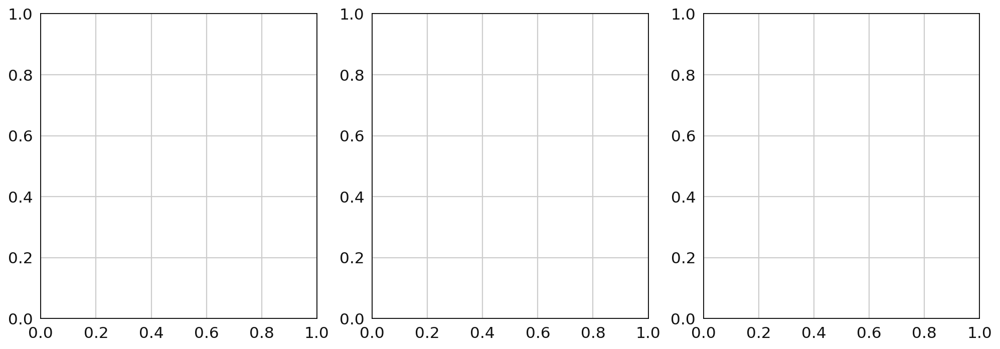

In [11]:
df_filt_cellpose = sp.pp.filter_data(
    df_se_cellpose, 
    nuc_thres=one_percent_nuc_cellpose, # remove cells with DAPI intensity below threshold
    size_thres=one_percent_area_cellpose, # remove cells with area below threshold
    nuc_marker="DAPI", # name of nuclear marker
    cell_size = "area", # name of cell size column
    region_column = "region_num", # column with region numbers
    color_by = "region_num", # color by region number
    log_scale=False) # log scale for size


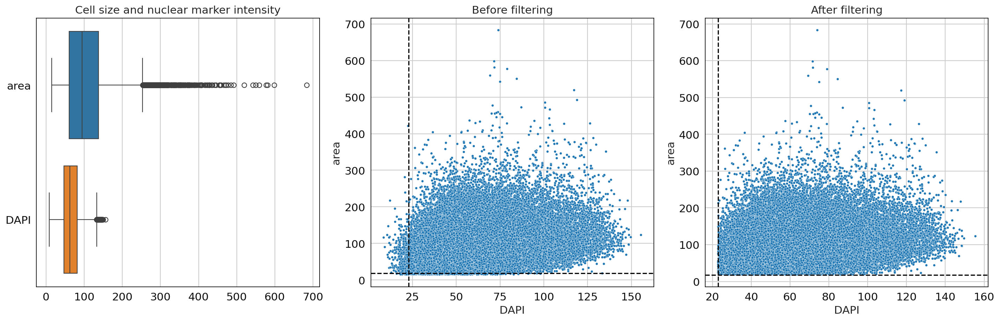

In [12]:
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# 左图：箱线图
sns.boxplot(data=df_se_cellpose[["area", "DAPI"]], orient='h', ax=axs[0])
axs[0].set_title("Cell size and nuclear marker intensity")

# 中图：filter 前
sns.scatterplot(data=df_se_cellpose, x="DAPI", y="area", hue="region_num", s=10, ax=axs[1], legend=False)
axs[1].axvline(one_percent_nuc_cellpose, color="black", linestyle="--")
axs[1].axhline(one_percent_area_cellpose, color="black", linestyle="--")
axs[1].set_title("Before filtering")

# 右图：filter 后
sns.scatterplot(data=df_filt_cellpose, x="DAPI", y="area", hue="region_num", s=10, ax=axs[2], legend=False)
axs[2].axvline(one_percent_nuc_cellpose, color="black", linestyle="--")
axs[2].axhline(one_percent_area_cellpose, color="black", linestyle="--")
axs[2].set_title("After filtering")

plt.tight_layout()
plt.show()

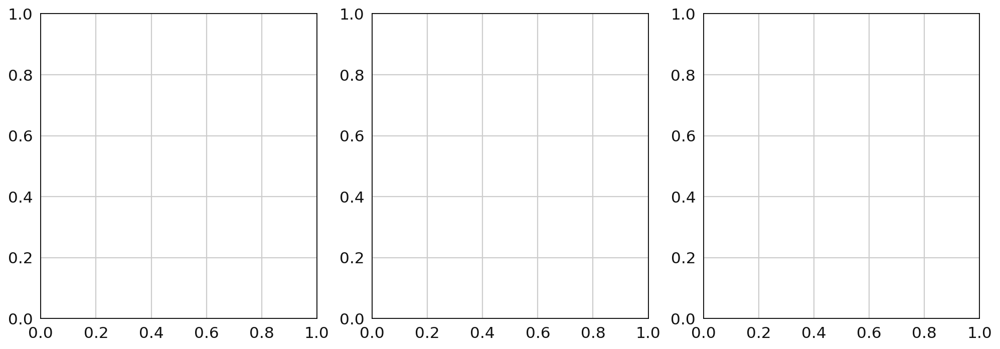

In [13]:
df_filt_mesmer = sp.pp.filter_data(
    df_se_mesmer, 
    nuc_thres=one_percent_nuc_mesmer, # remove cells with DAPI intensity below threshold
    size_thres=one_percent_area_mesmer, # remove cells with area below threshold
    nuc_marker="DAPI", # name of nuclear marker
    cell_size = "area", # name of cell size column
    region_column = "region_num", # column with region numbers
    color_by = "region_num", # color by region number
    log_scale=False) # log scale for size

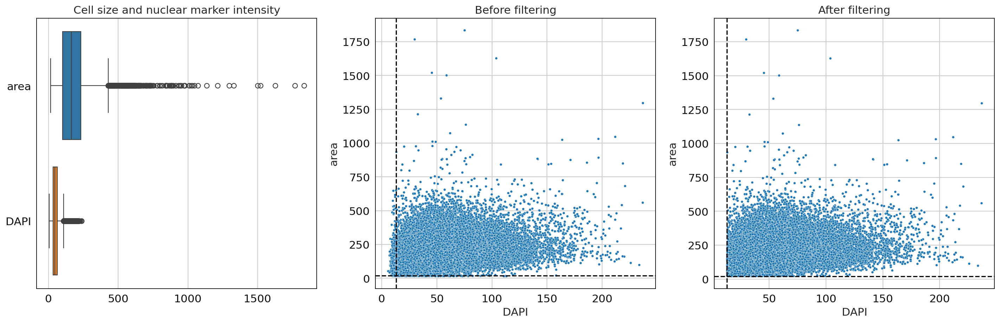

In [14]:
fig, axs = plt.subplots(1, 3, figsize=(18, 6))

# 左图：箱线图
sns.boxplot(data=df_se_mesmer[["area", "DAPI"]], orient='h', ax=axs[0])
axs[0].set_title("Cell size and nuclear marker intensity")

# 中图：filter 前
sns.scatterplot(data=df_se_mesmer, x="DAPI", y="area", hue="region_num", s=10, ax=axs[1], legend=False)
axs[1].axvline(one_percent_nuc_mesmer, color="black", linestyle="--")
axs[1].axhline(one_percent_area_mesmer, color="black", linestyle="--")
axs[1].set_title("Before filtering")

# 右图：filter 后
sns.scatterplot(data=df_filt_mesmer, x="DAPI", y="area", hue="region_num", s=10, ax=axs[2], legend=False)
axs[2].axvline(one_percent_nuc_mesmer, color="black", linestyle="--")
axs[2].axhline(one_percent_area_mesmer, color="black", linestyle="--")
axs[2].set_title("After filtering")

plt.tight_layout()
plt.show()

In [15]:
dfz_cellpose = pd.DataFrame()

for region in df_filt_cellpose.unique_region.unique():
    df_reg = df_filt_cellpose[df_filt_cellpose.unique_region == region]
    df_reg_norm = sp.pp.format(
        data=df_reg, 
        list_out= ['eccentricity', 'perimeter', 'convex_area', 'axis_major_length', 'axis_minor_length',  "label"], # list of features to remove
        list_keep = ["DAPI",'x','y', 'area','region_num',"unique_region"], # list of meta information that you would like to keep but don't want to normalize
        method = "zscore") # choose from "zscore", "double_zscore", "MinMax", "ArcSin"
    dfz_cellpose = pd.concat([dfz_cellpose,df_reg_norm], axis = 0)

dfz_cellpose.shape

(43951, 15)

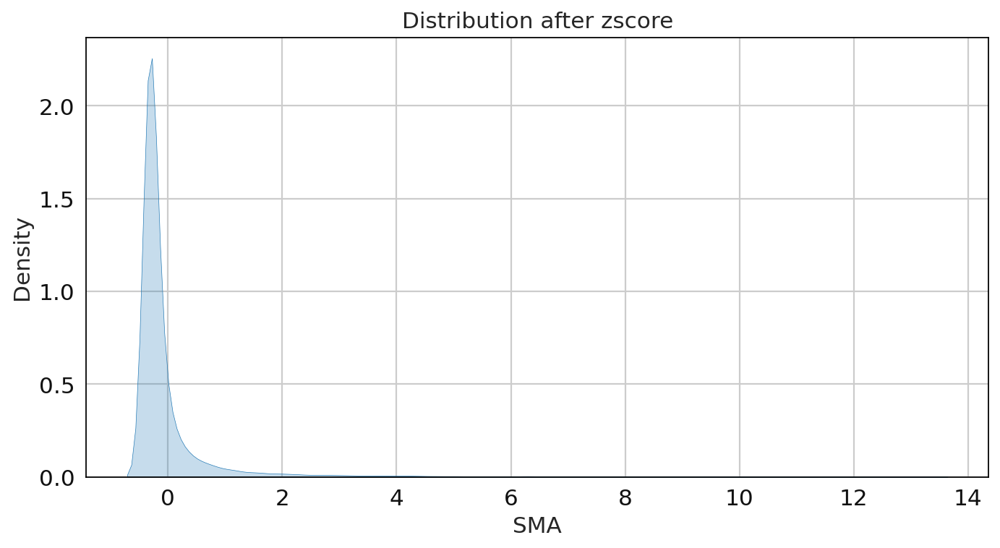

In [16]:
plt.figure(figsize=(10, 5))
sns.kdeplot(data=dfz_cellpose['SMA'], fill=True)
plt.title(f'Distribution after zscore')
plt.show()
plt.show()

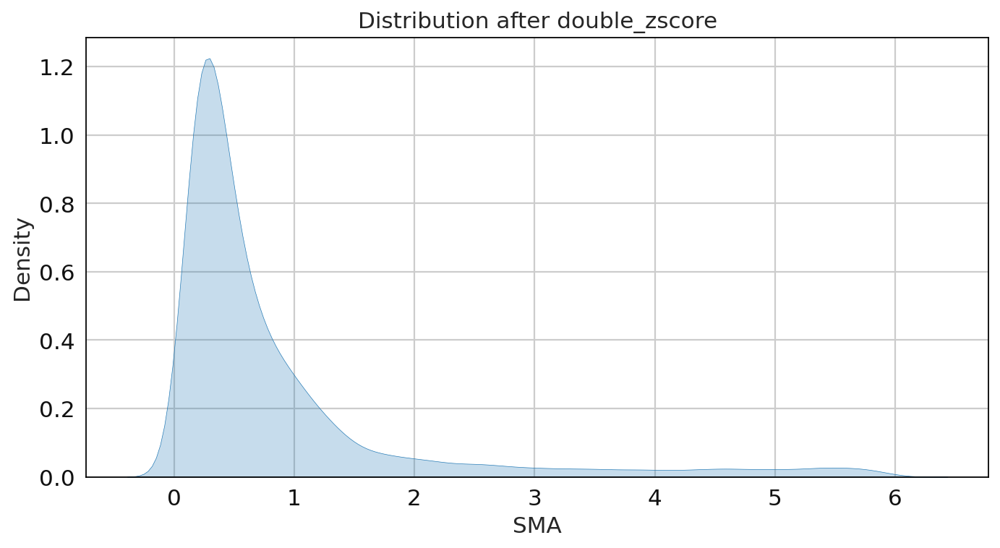

In [17]:
# This is to normalize the data per region/tif
dfz_2 = pd.DataFrame()

for region in df_filt_cellpose.unique_region.unique():
    df_reg = df_filt_cellpose[df_filt_cellpose.unique_region == region]
    df_reg_norm = sp.pp.format(
        data=df_reg, 
        list_out= ['eccentricity', 'perimeter', 'convex_area', 'axis_major_length', 'axis_minor_length',  "label"], # list of features to remove
        list_keep = ["DAPI",'x','y', 'area','region_num',"unique_region"], # list of meta information that you would like to keep but don't want to normalize
        method = "double_zscore") # choose from "zscore", "double_zscore", "MinMax", "ArcSin"
    dfz_2 = pd.concat([dfz_2,df_reg_norm], axis = 0)

dfz_2.shape

plt.figure(figsize=(10, 5))
sns.kdeplot(data=dfz_2['SMA'], fill=True)
plt.title(f'Distribution after double_zscore')
plt.show()
plt.show()

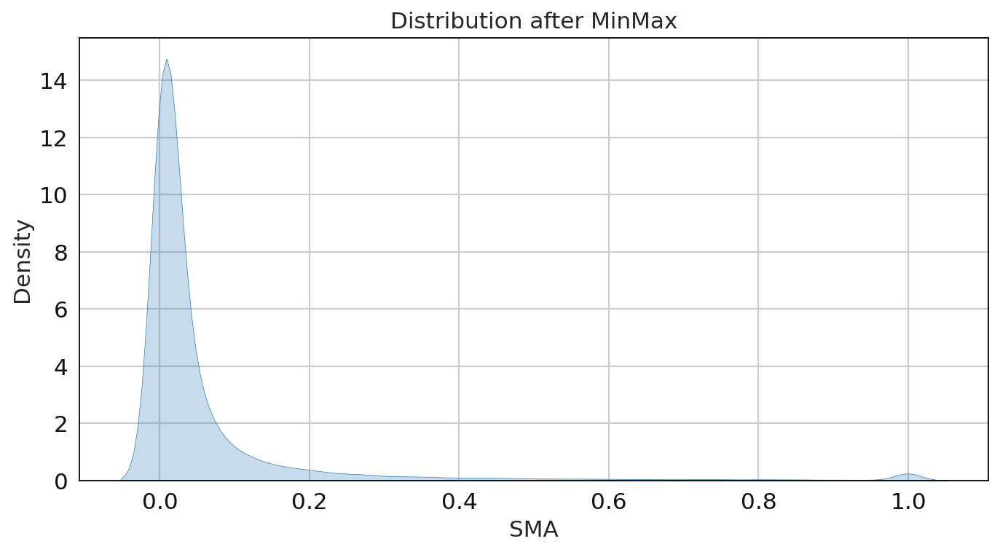

In [18]:
# This is to normalize the data per region/tif
dfz_3 = pd.DataFrame()

for region in df_filt_cellpose.unique_region.unique():
    df_reg = df_filt_cellpose[df_filt_cellpose.unique_region == region]
    df_reg_norm = sp.pp.format(
        data=df_reg, 
        list_out= ['eccentricity', 'perimeter', 'convex_area', 'axis_major_length', 'axis_minor_length',  "label"], # list of features to remove
        list_keep = ["DAPI",'x','y', 'area','region_num',"unique_region"], # list of meta information that you would like to keep but don't want to normalize
        method = "MinMax") # choose from "zscore", "double_zscore", "MinMax", "ArcSin"
    dfz_3 = pd.concat([dfz_3,df_reg_norm], axis = 0)

dfz_3.shape

plt.figure(figsize=(10, 5))
sns.kdeplot(data=dfz_3['SMA'], fill=True)
plt.title(f'Distribution after MinMax')
plt.show()
plt.show()

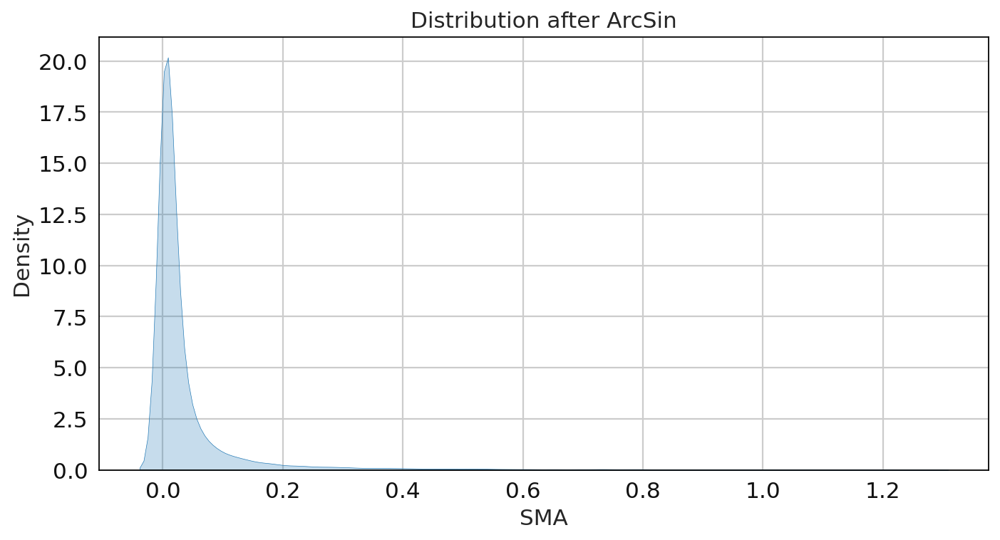

In [19]:
# This is to normalize the data per region/tif
dfz_4 = pd.DataFrame()

for region in df_filt_cellpose.unique_region.unique():
    df_reg = df_filt_cellpose[df_filt_cellpose.unique_region == region]
    df_reg_norm = sp.pp.format(
        data=df_reg, 
        list_out= ['eccentricity', 'perimeter', 'convex_area', 'axis_major_length', 'axis_minor_length',  "label"], # list of features to remove
        list_keep = ["DAPI",'x','y', 'area','region_num',"unique_region"], # list of meta information that you would like to keep but don't want to normalize
        method = "ArcSin") # choose from "zscore", "double_zscore", "MinMax", "ArcSin"
    dfz_4 = pd.concat([dfz_4,df_reg_norm], axis = 0)

dfz_4.shape

plt.figure(figsize=(10, 5))
sns.kdeplot(data=dfz_4['SMA'], fill=True)
plt.title(f'Distribution after ArcSin')
plt.show()
plt.show()

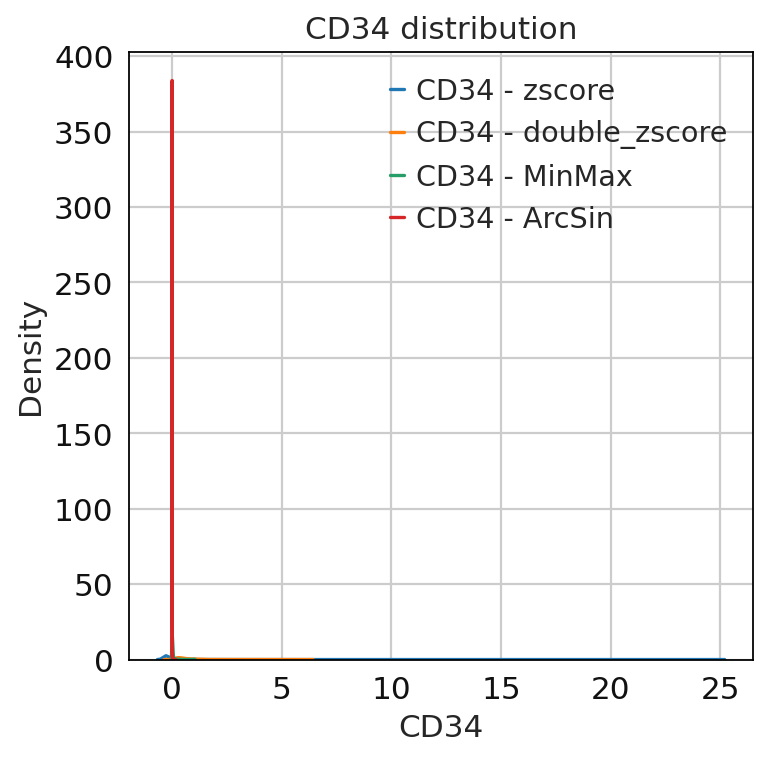

In [20]:
for marker in ['CD34']:
    plt.figure(figsize=(5, 5))
    sns.kdeplot(dfz_cellpose[marker], label=f'{marker} - zscore')
    sns.kdeplot(dfz_2[marker], label=f'{marker} - double_zscore')
    sns.kdeplot(dfz_3[marker], label=f'{marker} - MinMax')
    sns.kdeplot(dfz_4[marker], label=f'{marker} - ArcSin')
    plt.title(f'{marker} distribution')
    plt.legend()
    plt.show()

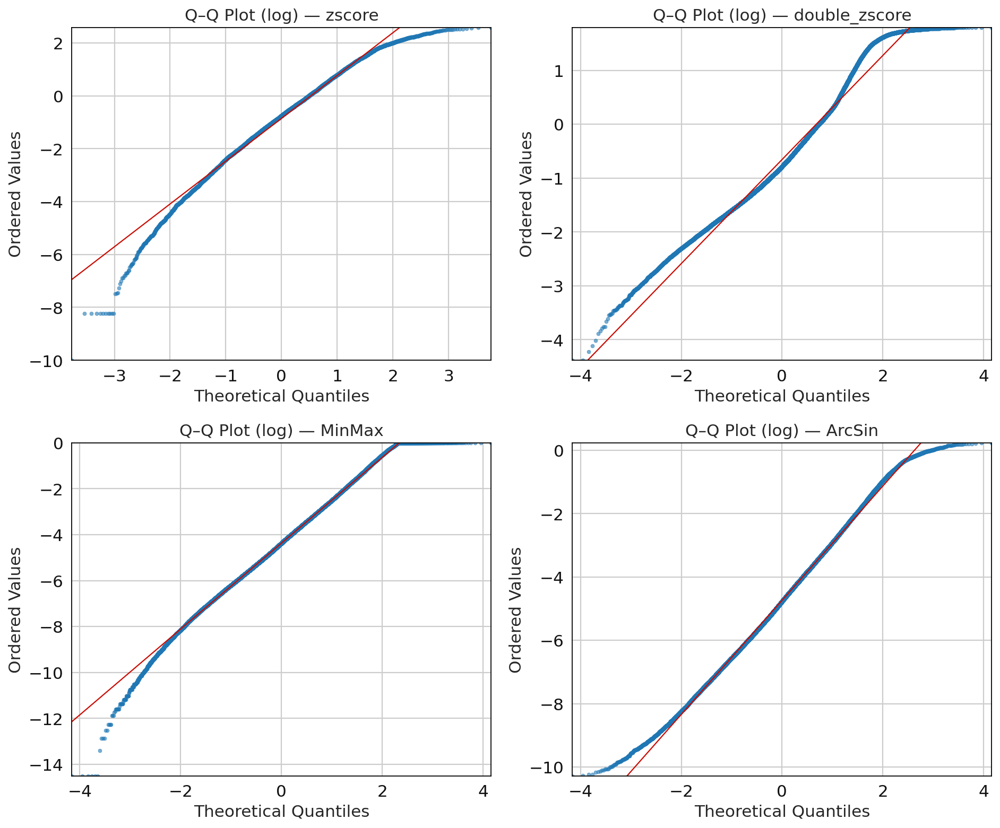

In [21]:
dfs = [dfz_cellpose, dfz_2, dfz_3, dfz_4]
methods = ["zscore", "double_zscore", "MinMax", "ArcSin"]

plt.figure(figsize=(12, 10))
for idx, (df, method) in enumerate(zip(dfs, methods), start=1):
    ax = plt.subplot(2, 2, idx)

    
    data = df['SMA'].dropna()
    data = data[data > 0]

    log_data = np.log(data)

    (theo_q, obs_q), (slope, intercept, r_value) = stats.probplot(log_data, dist="norm")

    mask = np.isfinite(theo_q) & np.isfinite(obs_q)
    theo_q, obs_q = theo_q[mask], obs_q[mask]

    ax.scatter(theo_q, obs_q, s=10, alpha=0.6)
    ax.plot(theo_q, slope * theo_q + intercept, 'r-', linewidth=1)

    ax.set_xlim(theo_q.min(), theo_q.max())
    ax.set_ylim(obs_q.min(), obs_q.max())

    ax.set_title(f"Q–Q Plot (log) — {method}")
    ax.set_xlabel("Theoretical Quantiles")
    ax.set_ylabel("Ordered Values")
    ax.grid(True)

plt.tight_layout()
plt.show()

In [22]:
dfs     = [dfz_cellpose, dfz_2, dfz_3, dfz_4]
methods = ["zscore", "double_zscore", "MinMax", "ArcSin"]

records = []
for df, method in zip(dfs, methods):
    x = df["SMA"].dropna()
    x = x[x > 0]
    x = np.log(x)

    stat_sw, p_sw = stats.shapiro(x)

    mu, sigma = x.mean(), x.std(ddof=1)
    stat_ks, p_ks = stats.kstest(x, "norm", args=(mu, sigma))

    records.append({
        "method":      method,
        "shapiro_p":   p_sw,
        "KS_p":        p_ks,
        "shapiro_sig": p_sw < 0.05,   # True 表示不符合正态
        "KS_sig":      p_ks < 0.05,
    })

tbl = pd.DataFrame(records)

failed = tbl[(tbl["shapiro_sig"]) | (tbl["KS_sig"])]

print("—— 所有方法检验结果 ——")
print(tbl.to_string(index=False))

print("\n—— 显著不符合正态分布的方法 ——")
if failed.empty:
    print("所有方法均未显著拒绝正态性（p ≥ 0.05）。")
else:
    print(failed[["method", "shapiro_p", "KS_p"]].to_string(index=False))

—— 所有方法检验结果 ——
       method    shapiro_p          KS_p  shapiro_sig  KS_sig
       zscore 2.461965e-30  1.021983e-06         True    True
double_zscore 4.304246e-61 1.059840e-103         True    True
       MinMax 1.199525e-29  4.734329e-04         True    True
       ArcSin 2.719057e-23  9.896220e-08         True    True

—— 显著不符合正态分布的方法 ——
       method    shapiro_p          KS_p
       zscore 2.461965e-30  1.021983e-06
double_zscore 4.304246e-61 1.059840e-103
       MinMax 1.199525e-29  4.734329e-04
       ArcSin 2.719057e-23  9.896220e-08


In [23]:
# get the column index for the last marker 
col_num_last_marker = dfz_cellpose.columns.get_loc('HLA-DR')
print(col_num_last_marker)

8


reg002


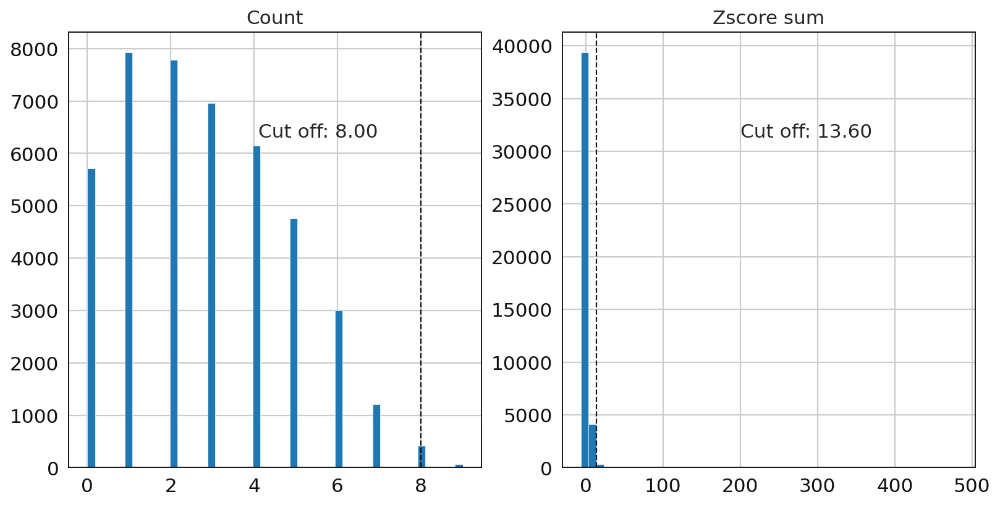

In [24]:
# This function helps to figure out what the cut-off should be for each region
for region in dfz_cellpose.unique_region.unique():
    print(region)
    df_reg = dfz_cellpose[dfz_cellpose.unique_region == region]
    sp.pl.zcount_thres(dfz = df_reg, 
                col_num = col_num_last_marker, # last antibody index
                cut_off=0.01, #top 1% of cells
                count_bin=50)

In [25]:
cutoff_list = [9, 13.6]
df_nn_cellpose, cc = sp.pp.remove_noise(
    df=df_reg, 
    col_num=col_num_last_marker,
    z_count_thres=cutoff_list[0],
    z_sum_thres=cutoff_list[1] 
)
df_nn_cellpose.shape

1.0% cells are removed.


(43511, 15)

In [26]:
df_nn_cellpose.to_csv(output_dir + "df_nn_cellpose_demo_fresh_frozen.csv")


In [27]:
adata_cellpose = sp.hf.make_anndata(
    df_nn = df_nn_cellpose,
    col_sum = col_num_last_marker, # this is the column index that has the last protein feature # the rest will go into obs
    nonFuncAb_list = [] # Remove the antibodies that are not working from the clustering step
)
adata_cellpose

AnnData object with n_obs × n_vars = 43511 × 9
    obs: 'DAPI', 'x', 'y', 'area', 'region_num', 'unique_region'

In [28]:
adata_cellpose.write_h5ad(output_dir + 'adata_cellpose_nn_demo_fresh_frozen.h5ad')


... storing 'region_num' as categorical
... storing 'unique_region' as categorical


In [29]:
import pickle
with open(output_dir + 'seg_output_region2_cellpose.pickle', 'rb') as f:
    overlay_data1 = pickle.load(f)

In [30]:
overlay_data1

{'img': array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
 'masks': array([[0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        ...,
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0],
        [0, 0, 0, ..., 0, 0, 0]], dtype=uint16),
 'image_dict': {'DAPI': array([[0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         ...,
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
  'Ki67': array([[0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         ...,
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0],
         [0, 0, 0, ..., 0, 0, 0]], dtype=uint8),
  'Keratin5': array([[0, 0, 0, ...,

In [31]:
df_nn_cellpose.columns


Index(['Ki67', 'Keratin5', 'CD68', 'Podoplanin', 'SMA', 'CD107a', 'CLDN17',
       'CD34', 'HLA-DR', 'DAPI', 'x', 'y', 'area', 'region_num',
       'unique_region'],
      dtype='object')

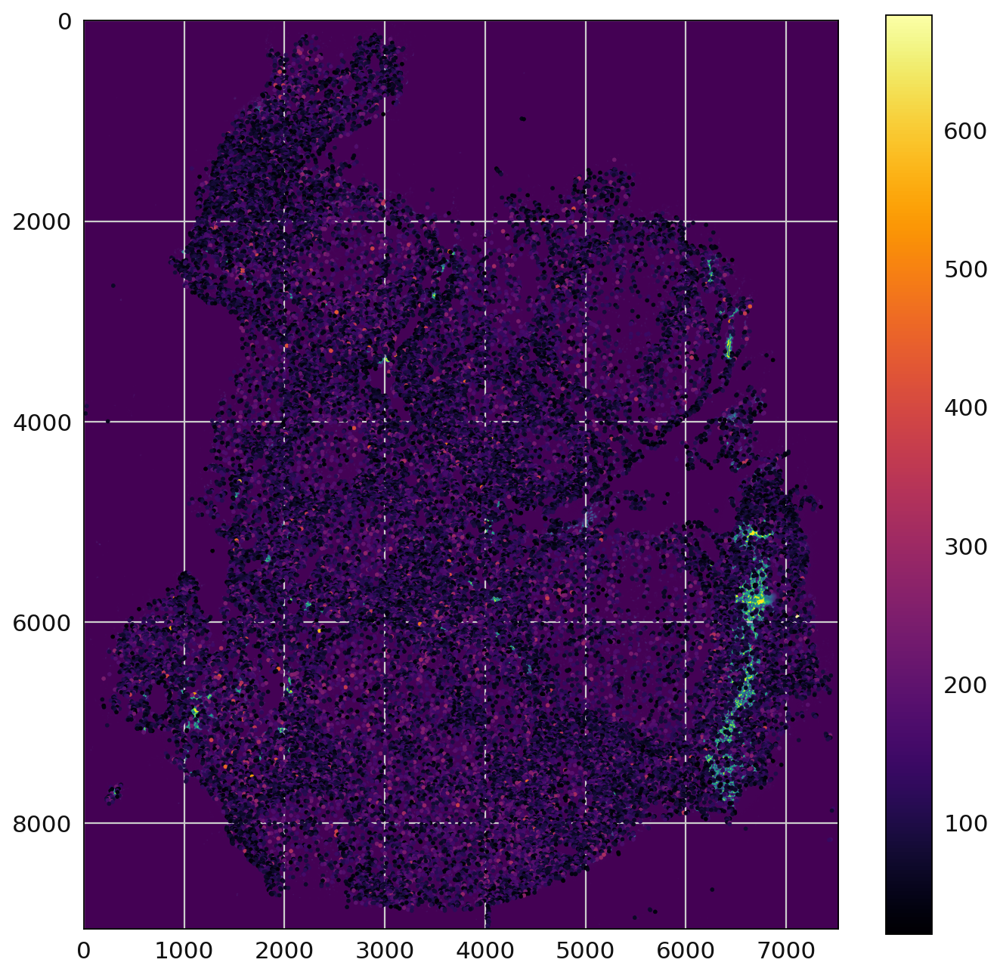

In [32]:
sp.pl.coordinates_on_image(
    df = df_nn_cellpose, 
    overlay_data = overlay_data1["img"], color='area',
    scale=False, # whether to scale to 1 or not
    dot_size=5,
    convert_to_grey=False, 
    fig_width=10, fig_height=10)

In [33]:
adata = sc.read(output_dir + 'adata_cellpose_nn_demo_fresh_frozen.h5ad')
adata # check the adata

AnnData object with n_obs × n_vars = 43511 × 9
    obs: 'DAPI', 'x', 'y', 'area', 'region_num', 'unique_region'

In [34]:
clustering_random_seed = 7

Computing neighbors and UMAP
- neighbors
- UMAP
Clustering
Leiden clustering


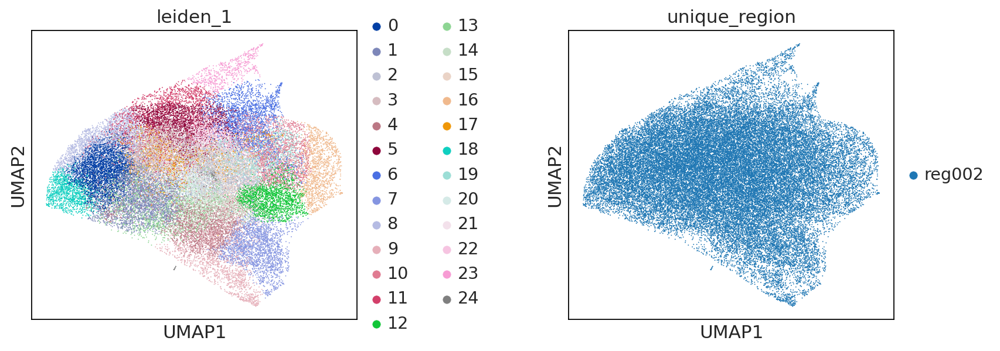

In [35]:
marker_list = ['Ki67', 'Keratin5', 'CD68', 'Podoplanin', 'SMA', 'CD107a',
       'CLDN17', 'CD34', 'HLA-DR']

adata_leiden = sp.tl.clustering(
    adata, 
    clustering='leiden', # can choose between leiden and louvian
    n_neighbors= 15, # number of neighbors for the knn graph
    resolution = 1, #clustering resolution (higher resolution gives more clusters)
    reclustering = False, # if true, no computing the neighbors
    marker_list = marker_list, #if it is None, all variable names are used for clustering
    seed=clustering_random_seed, # random seed for clustering - reproducibility
)

# visualization of clustering with UMAP
sc.pl.umap(adata_leiden, color = ['leiden_1', 'unique_region'], wspace=0.5)

使用的抗体通道： ['Ki67', 'Keratin5', 'CD68', 'Podoplanin', 'SMA', 'CD107a', 'CLDN17', 'CD34', 'HLA-DR']


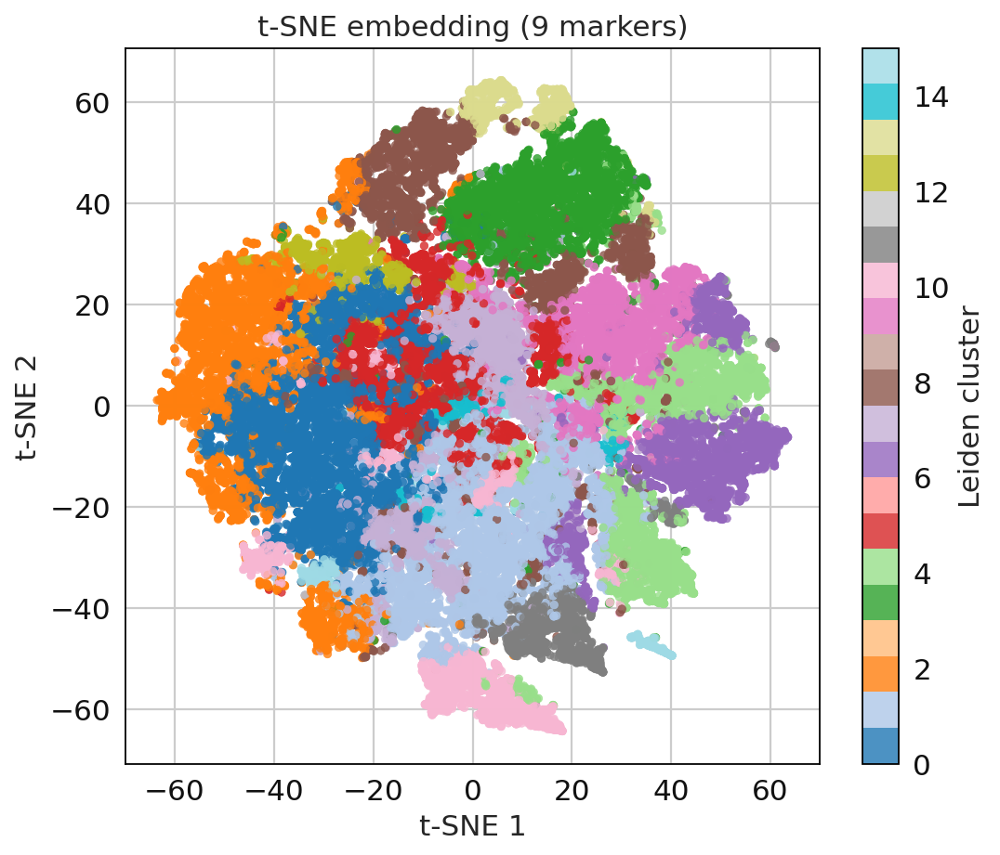

In [36]:
# Replace dfz with your DataFrame (e.g. dfz_1, dfz_2, etc.)
data = df_nn_cellpose
meta_cols = [
    'DAPI', 'x', 'y',
    'region_num', 'unique_region', 'label',
    'eccentricity','perimeter','convex_area',
    'area','axis_major_length','axis_minor_length'
]
marker_cols = [c for c in data.columns if c not in meta_cols]
print("使用的抗体通道：", marker_cols)

# 提取特征矩阵
X = data[marker_cols].values  # shape = (n_cells, 9)

X_scaled = StandardScaler().fit_transform(X)

# 2) t-SNE 嵌入
tsne = TSNE(
    n_components=2,
    perplexity=30,
    learning_rate=200,
    random_state=0,
    n_jobs=-1
)
X_tsne = tsne.fit_transform(X_scaled)

# 3) 构建 kNN 图（
knn_adj = kneighbors_graph(X_scaled, n_neighbors=15, mode='connectivity', include_self=False)
sources, targets = knn_adj.nonzero()
edges = list(zip(sources.tolist(), targets.tolist()))
g = ig.Graph(n=X_scaled.shape[0], edges=edges, directed=False).simplify()

# 4) Leiden 聚类
partition = leidenalg.find_partition(
    g,
    leidenalg.RBConfigurationVertexPartition,
    resolution_parameter=1.0
)
labels = np.array(partition.membership)
data['leiden'] = labels

# 5) 可视化 t-SNE 结果
plt.figure(figsize=(7,6))
sc = plt.scatter(
    X_tsne[:,0], X_tsne[:,1],
    c=labels,
    cmap='tab20',
    s=15,
    alpha=0.8
)
plt.colorbar(sc, label='Leiden cluster')
plt.title('t-SNE embedding (9 markers)')
plt.xlabel('t-SNE 1')
plt.ylabel('t-SNE 2')
plt.tight_layout()
plt.show()

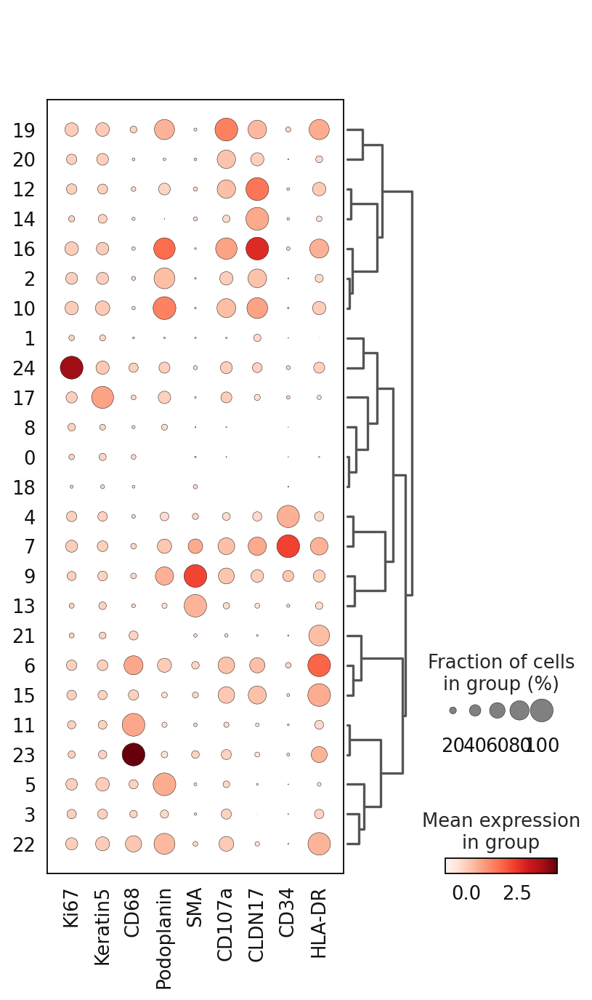

In [39]:
sc.pl.dotplot(adata_leiden, 
              marker_list, # The list of markers to show on the x-axis
              'leiden_1', # The cluster column
              dendrogram = True) # Show the dendrogram

In [40]:
sc.tl.leiden(adata_leiden, 
             seed=clustering_random_seed, # random seed for clustering - reproducibility
             restrict_to=('leiden_1',['0']), # select the cluster column name (your previously generated key) and the cluster name you want to subcluster
             resolution=0.3, # resolution for subclustering
             key_added='leiden_1_subcluster') # key added to adata.obs (keep it the same to avoid confusion and limit the adata object size)

# repeat the same for other clusters you want to subcluster
sc.tl.leiden(adata_leiden, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['2']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata_leiden, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['10']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata_leiden, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['12']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata_leiden, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['16']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata_leiden, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['18']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata_leiden, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['19']), resolution=0.3, key_added='leiden_1_subcluster')
sc.tl.leiden(adata_leiden, seed=clustering_random_seed, restrict_to=('leiden_1_subcluster',['22']), resolution=0.3, key_added='leiden_1_subcluster')


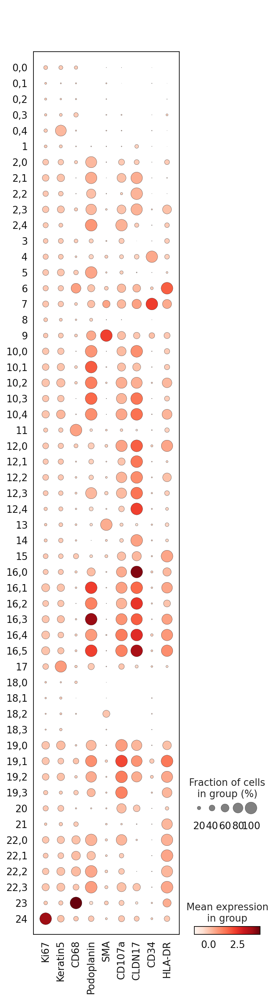

In [41]:
# Visualize cluster expression profiles 
sc.pl.dotplot(adata_leiden, 
              marker_list, 
              'leiden_1_subcluster', # The cluster column (now use the subcluster column)
              dendrogram = False)


In [42]:
cluster_to_ct_dict = {
    '0,0': 'Noise',
    '0,1': 'Noise',
    '0,2': 'Noise',
    '0,3': 'Noise',
    '0,4': 'basal tumor cells',
    '1': 'Noise',
    '2,0': 'myCAFs',
    '2,1': 'myCAFs and classical tumor cells',
    '2,2': 'myCAFs and classical tumor cells',
    '2,3': 'myCAFs and classical tumor cells',
    '2,4': 'myCAFs and Immune cells',
    '3,0': 'recluster',
    '3': 'Noise',
    '4': 'Endothelial cells',
    '5': 'myCAFs',
    '6': 'Macrophages',
    '7': 'Endothelial cells',
    '8': 'Noise',
    '9': 'myCAFs',
    '10,0': 'recluster',
    '10,1': 'recluster',
    '10,2': 'recluster',
    '10,3': 'recluster',
    '10,4': 'recluster',   
    '11': 'Macrophages',
    '12,0': 'classical tumor cells and Immune cells',
    '12,1': 'classical tumor cells',
    '12,2': 'classical tumor cells and Immune cells',
    '12,3': 'recluster',
    '12,4': 'classical tumor cells',
    '13': 'myCAFs',
    '14': 'classical tumor cells',
    '15': 'Noise',
    '16,0': 'recluster',
    '16,1': 'recluster',
    '16,2': 'recluster',
    '16,3': 'recluster', 
    '16,4': 'recluster',
    '16,5': 'recluster',
    '17': 'basal tumor cells',
    '18,0': 'Noise',
    '18,1': 'Noise',
    '18,2': 'Noise',
    '18,3': 'Noise',
    '19,0': 'recluster',
    '19,1': 'recluster',
    '19,2': 'recluster',
    '19,3': 'recluster',
    '20': 'Immune cells',
    '21': 'Noise',
    '22,0': 'myCAFs',
    '22,1': 'myCAFs',
    '22,2': 'myCAFs',
    '22,3': 'myCAFs',
    '23': 'Macrophages',
    '24': 'Proliferating',
    

}

# This allows us to generate a new column named cell_type_coarse based on the leiden_1_subcluster column
adata_leiden.obs['cell_type_coarse'] = ( # create a new column
    adata_leiden.obs['leiden_1_subcluster'] # get the cluster names
    .map(cluster_to_ct_dict) # map the cluster names to cell types
    .astype('category') # convert to category
)

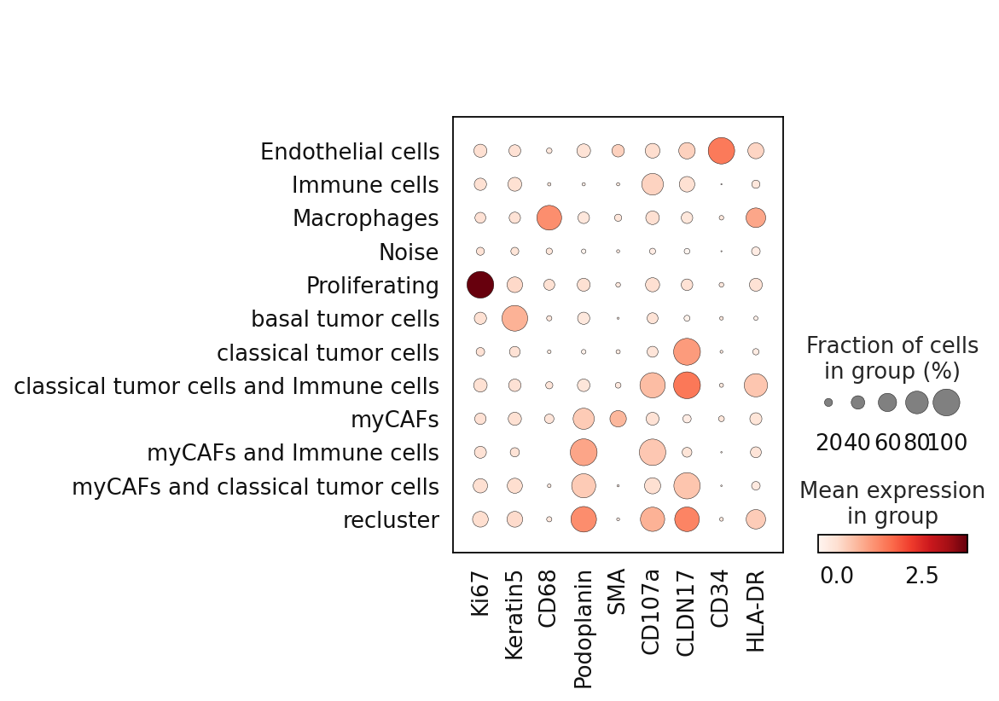

In [43]:
# Check the marker expression of the annotated cell types
sc.pl.dotplot(adata_leiden, marker_list, 'cell_type_coarse', dendrogram = False)

,x,y,cell_type_coarse,unique_region
0,2899.282051,141.538462,Noise,reg002
1,2895.562500,153.593750,Noise,reg002
2,2212.060606,157.303030,classical tumor cells,reg002
3,2289.322034,158.118644,Noise,reg002
4,2181.550000,162.100000,myCAFs and classical tumor cells,reg002
...,...,...,...,...
43506,4028.971831,8984.338028,classical tumor cells,reg002
43507,4038.054945,8985.076923,Noise,reg002
43508,4032.782609,9017.750000,Macrophages,reg002
43509,4023.413793,9025.836207,basal tumor cells,reg002


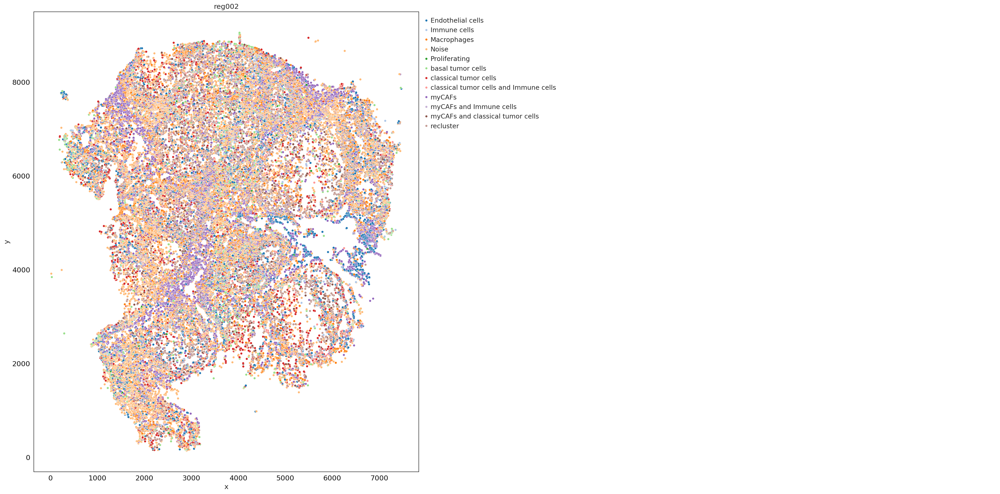

In [47]:
sp.pl.catplot(
    adata_leiden, 
    color = "cell_type_coarse", # specify group column name here (e.g. celltype_fine)
    unique_region = "unique_region", # specify unique_regions here
    X='x', Y='y', # specify x and y columns here
    n_columns=2, # adjust the number of columns for plotting here (how many plots do you want in one row?)
    palette='tab20', #default is None which means the color comes from the anndata.uns that matches the UMAP
    savefig=True, # save figure as pdf
    output_fname = "Fresh_frozen_reg2_first_clustering", # change it to file name you prefer when saving the figure
    output_dir=output_dir, # specify output directory here (if savefig=True)
    figsize= 17, # specify the figure size here
    size = 20) # specify the size of the points

In [48]:
adata_leiden.obs['cell_type_coarse'].value_counts()

cell_type_coarse
Noise                                     14050
myCAFs                                     7731
Macrophages                                4758
recluster                                  4727
Endothelial cells                          4494
classical tumor cells                      2291
myCAFs and classical tumor cells           1670
basal tumor cells                          1568
Immune cells                               1108
classical tumor cells and Immune cells      932
Proliferating                               132
myCAFs and Immune cells                      50
Name: count, dtype: int64

In [49]:
sc.tl.leiden(adata_leiden, 
             seed=clustering_random_seed, 
             restrict_to=('cell_type_coarse',['recluster']), # select the cluster column name (your previously generated key) and the cluster name you want to subcluster
             resolution=1.5,
             key_added='cell_type_coarse_subcluster') # new column added to adata.obs

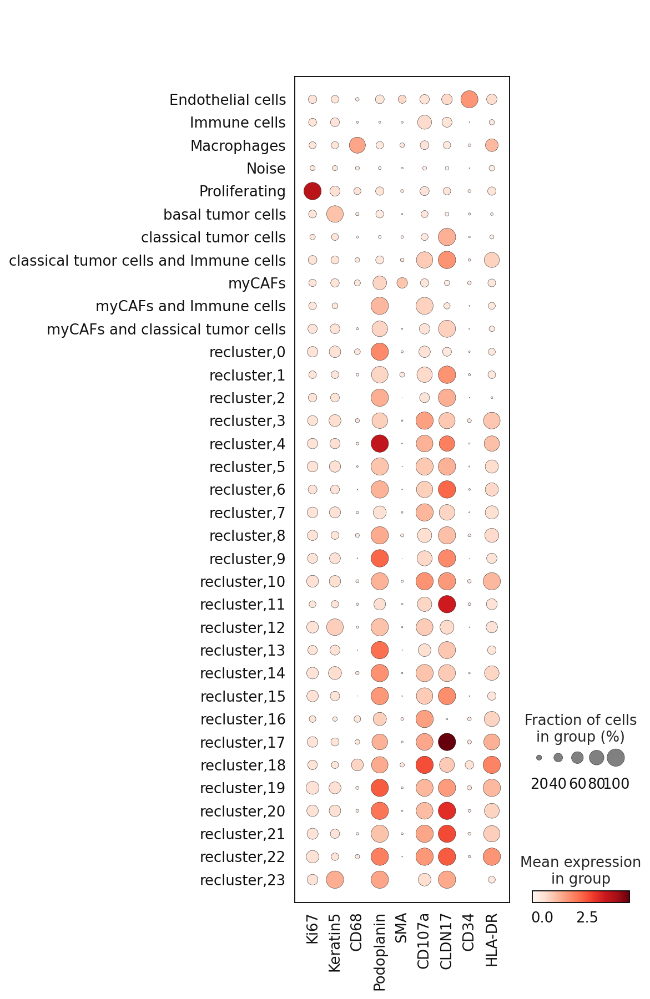

In [50]:
sc.pl.dotplot(adata_leiden, marker_list, 'cell_type_coarse_subcluster', dendrogram = False)

In [51]:
cluster_to_ct_dict = {  
    'Noise': 'Noise',
    'myCAFs': 'myCAFs',
    'Macrophages': 'Macrophages', 
    'Endothelial cells':'Endothelial cells',
    'classical tumor cells': 'classical tumor cells', 
    'myCAFs and classical tumor cells': 'myCAFs and classical tumor cells',
    'basal tumor cells': 'basal tumor cells',
    'Immune cells': 'Immune cells',
    'classical tumor cells and Immune cells': 'classical tumor cells and Immune cells',
    'Proliferating': 'Proliferating',
    'myCAFs and Immune cells': 'myCAFs and Immune cells',
    'recluster,0': 'myCAFs',
    'recluster,1': 'recluster',
    'recluster,2': 'myCAFs and classical tumor cells',
    'recluster,3': 'recluster',
    'recluster,4': 'recluster',
    'recluster,5': 'recluster',
    'recluster,6': 'recluster',
    'recluster,7': 'Immune cells',
    'recluster,8': 'recluster',
    'recluster,9': 'recluster',
    'recluster,10': 'recluster',
    'recluster,11': 'classical tumor cells',
    'recluster,12': 'recluster',
    'recluster,13': 'myCAFs and classical tumor cells',
    'recluster,14': 'recluster',
    'recluster,15': 'recluster',
    'recluster,16': 'Immune cells',
    'recluster,17': 'recluster',
    'recluster,18': 'recluster',
    'recluster,19': 'recluster',
    'recluster,20': 'recluster',
    'recluster,21': 'recluster',
    'recluster,22': 'recluster',
    'recluster,23': 'recluster',
    'recluster,24': 'recluster',
    'recluster,25': 'recluster',

}

adata_leiden.obs['cell_type_coarse_f'] = (
    adata_leiden.obs['cell_type_coarse_subcluster']
    .map(cluster_to_ct_dict)
    .astype('category')
)

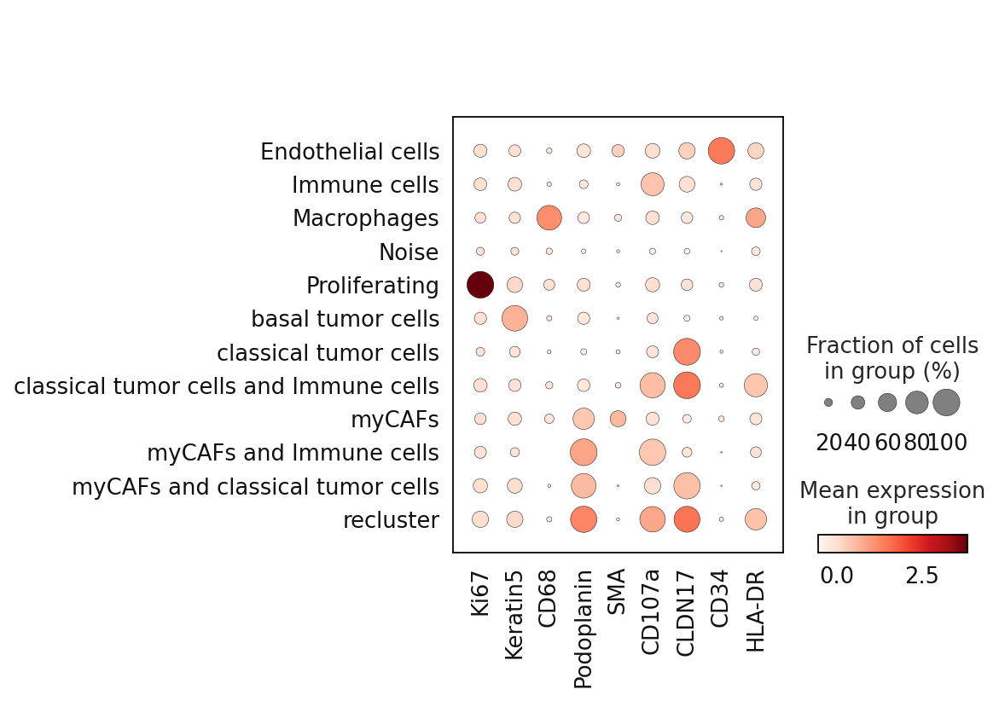

In [52]:
sc.pl.dotplot(adata_leiden, marker_list, 'cell_type_coarse_f', dendrogram = False)

In [53]:
adata_leiden.obs['cell_type_coarse_f'].value_counts()


cell_type_coarse_f
Noise                                     14050
myCAFs                                     8024
Macrophages                                4758
Endothelial cells                          4494
recluster                                  3360
classical tumor cells                      2496
myCAFs and classical tumor cells           2147
basal tumor cells                          1568
Immune cells                               1500
classical tumor cells and Immune cells      932
Proliferating                               132
myCAFs and Immune cells                      50
Name: count, dtype: int64

In [54]:
adata = adata_leiden[~adata_leiden.obs['cell_type_coarse_f'].isin(['Noise'])]


In [55]:
sc.tl.leiden(adata, seed=clustering_random_seed, restrict_to=('cell_type_coarse_f',['recluster']), resolution=1.5, key_added='cell_type_coarse_f_subcluster')

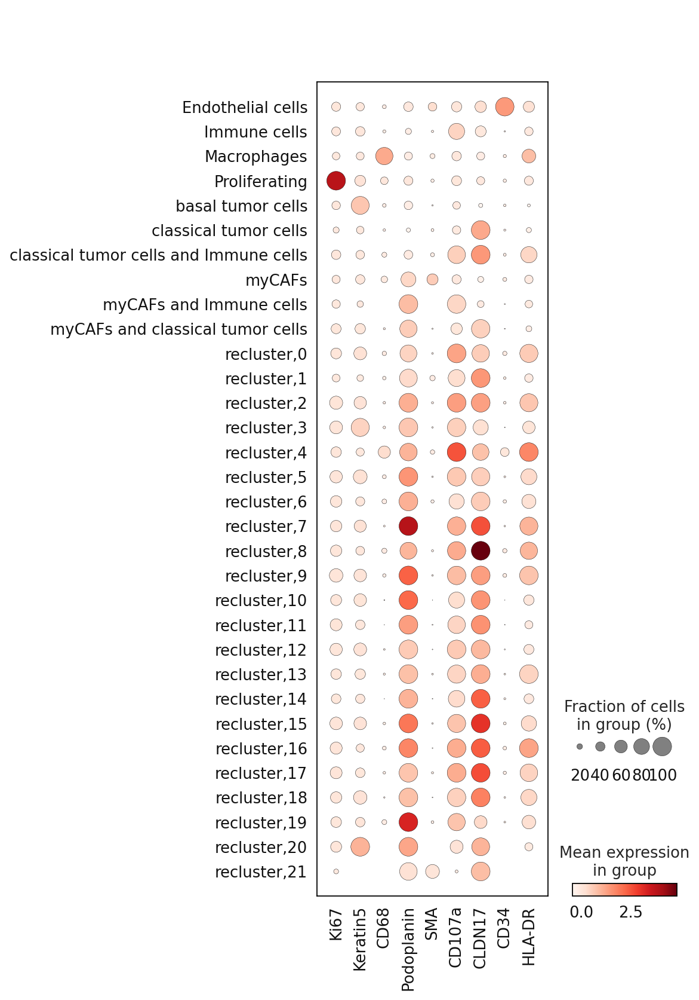

In [56]:
sc.pl.dotplot(adata, marker_list, 'cell_type_coarse_f_subcluster', dendrogram = False)

In [57]:
adata.layers["scaled"] = sc.pp.scale(adata, copy=True).X

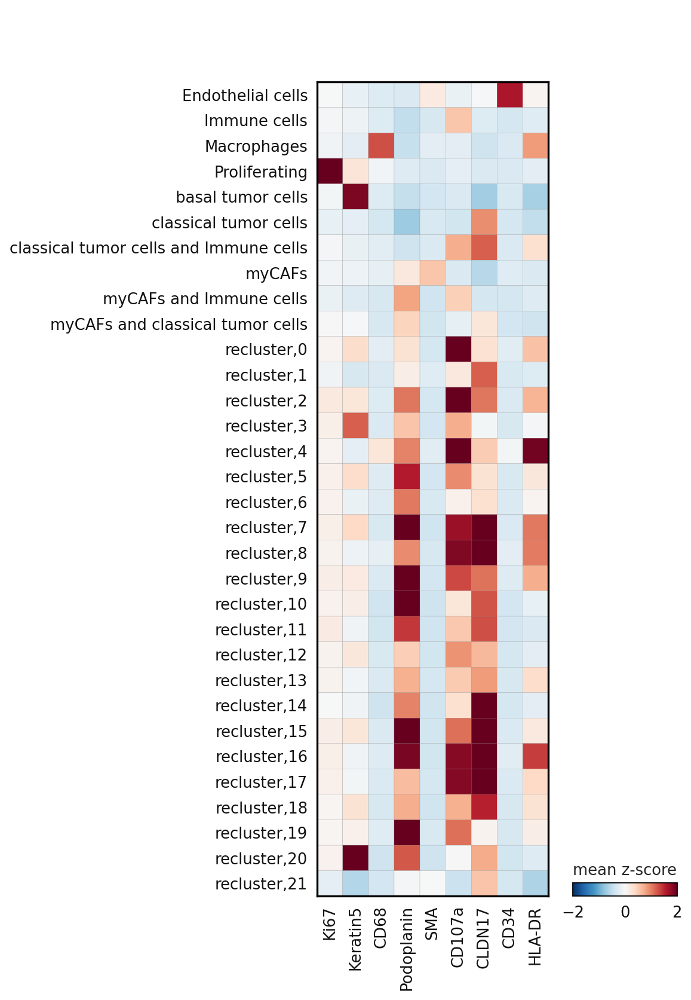

In [58]:
sc.pl.matrixplot(
    adata,
    marker_list,
    "cell_type_coarse_f_subcluster",
    dendrogram=False,
    colorbar_title="mean z-score",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
)

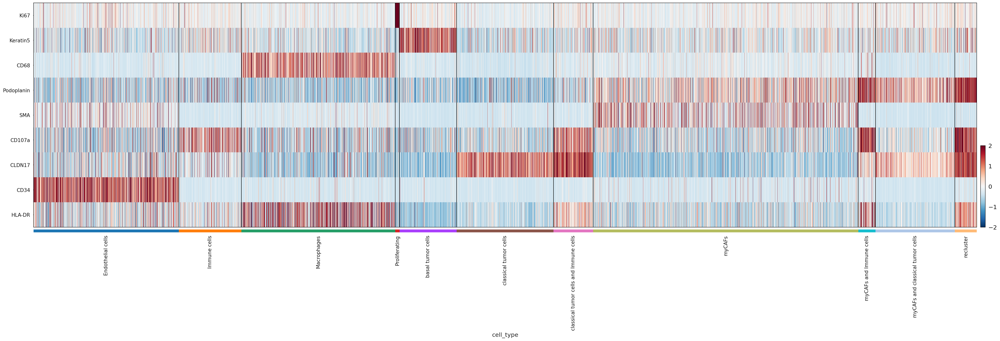

In [59]:
cluster_to_ct_dict = {
    'myCAFs': 'myCAFs',
    'Macrophages': 'Macrophages', 
    'Endothelial cells':'Endothelial cells',
    'classical tumor cells': 'classical tumor cells', 
    'myCAFs and classical tumor cells': 'myCAFs and classical tumor cells',
    'basal tumor cells': 'basal tumor cells',
    'Immune cells': 'Immune cells',
    'classical tumor cells and Immune cells': 'classical tumor cells and Immune cells',
    'Proliferating': 'Proliferating',
    'myCAFs and Immune cells': 'myCAFs and Immune cells',
    'recluster,0': 'Immune cells',
    'recluster,1': 'classical tumor cells',
    
    'recluster,2': 'recluster',
    'recluster,3': 'basal tumor cells',
    'recluster,4': 'myCAFs and Immune cells',
    'recluster,5': 'myCAFs and Immune cells',
    'recluster,6': 'myCAFs',
    
    'recluster,7': 'Immune cells',
    'recluster,8': 'classical tumor cells and Immune cells',
    
    'recluster,9': 'recluster',
    'recluster,10': 'myCAFs and classical tumor cells',
    'recluster,11': 'myCAFs and classical tumor cells',
    'recluster,12': 'Noise',
    'recluster,13': 'Noise',
    
    'recluster,14': 'classical tumor cells',
    'recluster,15': 'recluster',
    'recluster,16': 'recluster',
    'recluster,17': 'classical tumor cells and Immune cells',
    'recluster,18': 'classical tumor cells',
    'recluster,19': 'myCAFs and Immune cells',
    'recluster,20': 'recluster',
    'recluster,21': 'Noise',

}
adata.obs['cell_type'] = (
    adata.obs['cell_type_coarse_f_subcluster']
    .map(cluster_to_ct_dict)
    .astype('category')
)
adata = adata[~adata.obs['cell_type'].isin(['Noise'])]
sc.pl.heatmap(
    adata,
    marker_list,
    groupby="cell_type",
    layer="scaled",
    vmin=-2,
    vmax=2,
    cmap="RdBu_r",
    dendrogram=False,
    swap_axes=True,
    figsize=(40, 10),
    show=True
)

In [60]:
adata.write(output_dir + "adata_nn_demo_annotated_fresh_frozen.h5ad")

In [61]:
adata.obs['cell_type'].value_counts()

cell_type
myCAFs                                    8198
Macrophages                               4758
Endothelial cells                         4494
classical tumor cells                     2995
myCAFs and classical tumor cells          2453
Immune cells                              1931
basal tumor cells                         1767
classical tumor cells and Immune cells    1223
recluster                                  677
myCAFs and Immune cells                    532
Proliferating                              132
Name: count, dtype: int64

,x,y,cell_type,unique_region
2,2212.060606,157.303030,classical tumor cells,reg002
4,2181.550000,162.100000,myCAFs and classical tumor cells,reg002
5,2906.862069,158.908046,basal tumor cells,reg002
7,2912.666667,166.000000,classical tumor cells,reg002
8,2929.105882,170.129412,Macrophages,reg002
...,...,...,...,...
43505,4036.687500,8967.937500,classical tumor cells,reg002
43506,4028.971831,8984.338028,classical tumor cells,reg002
43508,4032.782609,9017.750000,Macrophages,reg002
43509,4023.413793,9025.836207,basal tumor cells,reg002


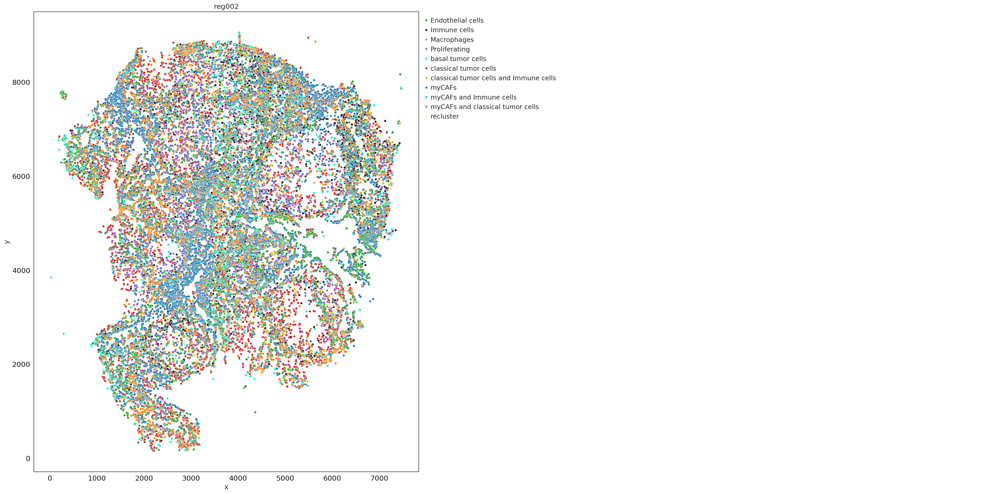

In [63]:
cell_type_colors = {
    'myCAFs' : '#1f77b4',           
    'Macrophages' : '#ff7f0e',        
    'Endothelial cells' : '#2ca02c',                
    'classical tumor cells' : '#d62728',           
    'myCAFs and classical tumor cells' : '#9467bd',     
    'basal tumor cells' : '#0ff4c6',     
    'Immune cells' : '#321325',               
    'classical tumor cells and Immune cells': '#bcbd22',
    'Proliferating': '#7f7f7f',
    'myCAFs and Immune cells': '#17becf',
    'recluster' : '#f7dba7',
}
sp.pl.catplot(
    adata, 
    color = "cell_type", # specify group column name here (e.g. celltype_fine)
    unique_region = "unique_region", # specify unique_regions here
    X='x', Y='y', # specify x and y columns here
    n_columns=2, # adjust the number of columns for plotting here (how many plots do you want in one row?)
    palette=cell_type_colors, #default is None which means the color comes from the anndata.uns that matches the UMAP
    savefig=True, # save figure as pdf
    output_fname = "cell_type_fresh_frozen_reg2", # change it to file name you prefer when saving the figure
    output_dir=output_dir, # specify output directory here (if savefig=True)
    figsize= 17,
    size = 20)

,x,y,cell_type,unique_region
2,2212.060606,157.303030,classical tumor cells,reg002
4,2181.550000,162.100000,myCAFs and classical tumor cells,reg002
5,2906.862069,158.908046,basal tumor cells,reg002
7,2912.666667,166.000000,classical tumor cells,reg002
8,2929.105882,170.129412,Macrophages,reg002
...,...,...,...,...
43505,4036.687500,8967.937500,classical tumor cells,reg002
43506,4028.971831,8984.338028,classical tumor cells,reg002
43508,4032.782609,9017.750000,Macrophages,reg002
43509,4023.413793,9025.836207,basal tumor cells,reg002


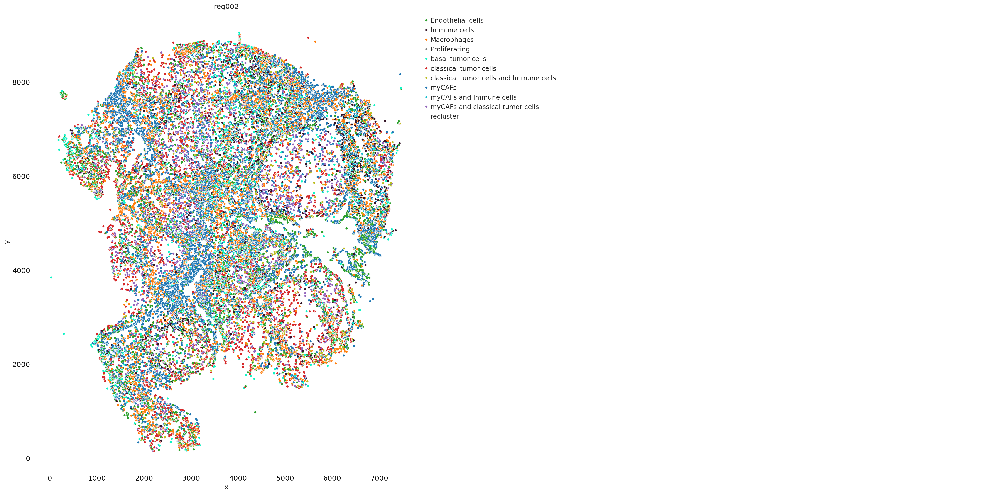

In [64]:
cell_type_colors_1 = {
    'myCAFs' : '#1f77b4',           
    'Macrophages' : '#ff7f0e',        
    'Endothelial cells' : '#2ca02c',                
    'classical tumor cells' : '#d62728',           
    'myCAFs and classical tumor cells' : '#9467bd',     
    'basal tumor cells' : '#0ff4c6',     
    'Immune cells' : '#321325',               
    'classical tumor cells and Immune cells': '#bcbd22',
    'Proliferating': '#7f7f7f',
    'myCAFs and Immune cells': '#17becf',
    'recluster' : 'white',
}
sp.pl.catplot(
    adata, 
    color = "cell_type", # specify group column name here (e.g. celltype_fine)
    unique_region = "unique_region", # specify unique_regions here
    X='x', Y='y', # specify x and y columns here
    n_columns=2, # adjust the number of columns for plotting here (how many plots do you want in one row?)
    palette=cell_type_colors_1, #default is None which means the color comes from the anndata.uns that matches the UMAP
    savefig=True, # save figure as pdf
    output_fname = "cell_type_fresh_frozen_reg2_1", # change it to file name you prefer when saving the figure
    output_dir=output_dir, # specify output directory here (if savefig=True)
    figsize= 17,
    size = 20)

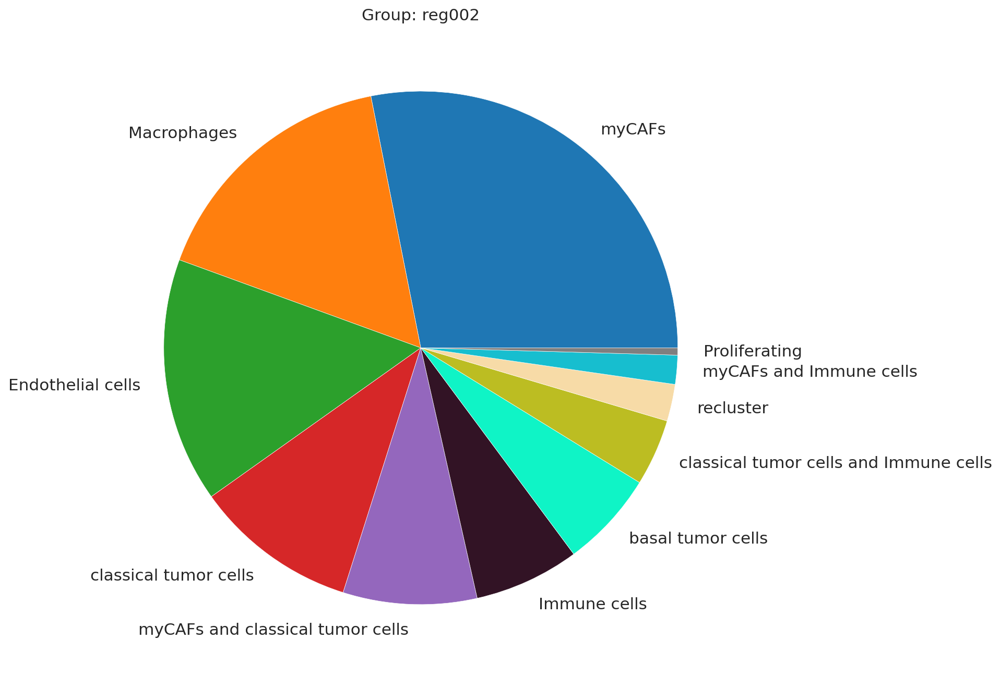

In [66]:
sp.pl.create_pie_charts(
    adata,
    color = "cell_type",  
    show_percentages=False,
    grouping = "unique_region",
    palette=cell_type_colors, #default is None which means the color comes from the anndata.uns that matches the UMAP
    savefig=True, # change it to true if you want to save the figure
    output_fname = "cell_type_pie_charts_fresh_frozen",# change it to file name you prefer when saving the figure
    output_dir = output_dir #output directory for the figure
)
fig = plt.gcf()
fig.set_size_inches(60, 60)
